**Importing Modules**

In [16]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential , Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

**Load files**

In [21]:
BASE_DIR = 'D:/Anime Face Generator using DCGAN/kaggle notebook/kaggle/input/anime-faces/data/data'

In [22]:
#load all image files to a list
image_paths =[]
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)


**Visializing Image Dataset**

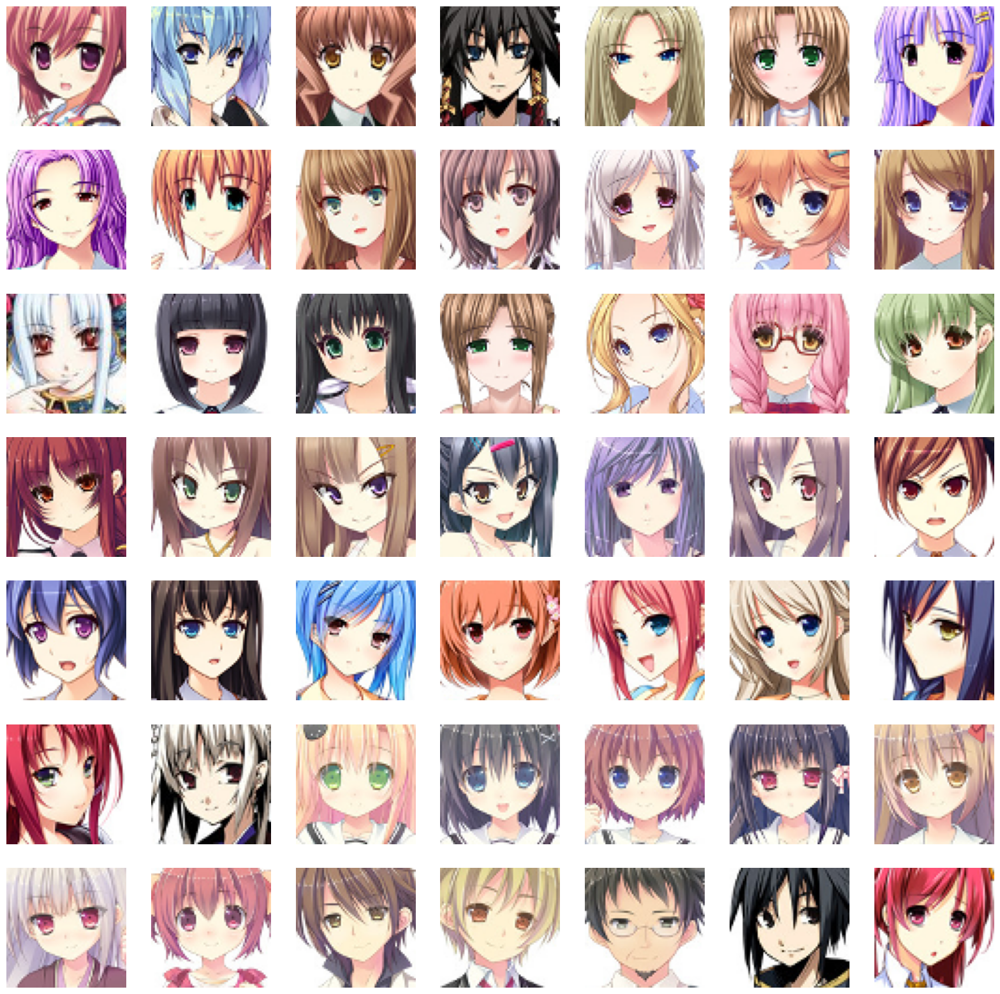

In [23]:
#displaying a grid of images
plt.figure(figsize=(20,20))
temp_images = image_paths[:49] #grid of 7X7 images
index=1
for image_path in temp_images :
    plt.subplot(7,7,index)
    #load the image
    img = load_img(image_path)
    #convert to numpy array
    img = np.array(img)

    #display the image
    plt.imshow(img)
    plt.axis('off')
    #increment the index to load next image
    index +=1

**preprocess images**

In [24]:
#load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [25]:
train_images[0].shape

(64, 64, 3)

In [26]:
#reshape the images
# 64 ,64 => height X width
# 3 => RGB images . If greyscale images then 1
train_images = train_images.reshape(train_images.shape[0],64,64,3).astype('float32')

In [27]:
#normalize the image 
# normally we normalize in range [0,1] but in GANs we have activation layer in tanh function which gives output in range [-1,-1]
train_images = (train_images - 127.5) / 127.5  

In [28]:
train_images[0]

array([[[ 0.94509804,  0.42745098,  0.24705882],
        [ 0.96862745,  0.44313726,  0.33333334],
        [ 0.9529412 ,  0.5058824 ,  0.35686275],
        ...,
        [ 0.38039216, -0.38039216, -0.19215687],
        [ 0.43529412, -0.34117648, -0.15294118],
        [ 0.49019608, -0.1764706 , -0.02745098]],

       [[ 0.90588236,  0.43529412,  0.23137255],
        [ 0.92941177,  0.43529412,  0.3254902 ],
        [ 0.9529412 ,  0.44313726,  0.35686275],
        ...,
        [ 0.33333334, -0.3647059 , -0.19215687],
        [ 0.39607844, -0.37254903, -0.16862746],
        [ 0.35686275, -0.3647059 , -0.19215687]],

       [[ 0.8980392 ,  0.4117647 ,  0.2627451 ],
        [ 0.96862745,  0.4745098 ,  0.33333334],
        [ 0.75686276,  0.14509805,  0.16078432],
        ...,
        [ 0.40392157, -0.31764707, -0.12156863],
        [ 0.38039216, -0.37254903, -0.16078432],
        [ 0.35686275, -0.40392157, -0.20784314]],

       ...,

       [[ 1.        ,  1.        ,  1.        ],
        [ 1

**Create Generator and Discriminator Models**

In [29]:
#latent dimension for random noise
LATENT_DIM = 128 #based on latent dimension specified we generate variety in images.More the latent noise more is the variety of images
#weight initilizer
WEIGHT_INIT = keras.initializers.RandomNormal(mean = 0.0, stddev =0.02)
#no of channels of the image
CHANNELS=3

**Generator Model**

this will create new images similar to training data from random noise

In [30]:
model = Sequential(name='generator')
#id random noise
model.add(layers.Dense(8*8*512,input_dim = LATENT_DIM))
model.add(layers.ReLU())

#convert id to 3d

model.add(layers.Reshape((8,8,512)))

#upsample to 16x16
model.add(layers.Conv2DTranspose(256,(4,4),strides=(2,2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.BatchNormalization())
model.add(layers.ReLU())

#upsample to 32x32
model.add(layers.Conv2DTranspose(128,(4,4),strides=(2,2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.BatchNormalization())
model.add(layers.ReLU())

#upsample to 64x64
model.add(layers.Conv2DTranspose(64,(4,4),strides=(2,2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS,(4,4),padding='same',activation='tanh'))

generator = model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 32768)          │     4,227,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu (ReLU)                    │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 16, 16, 256)    │     2,097,408 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 16, 16, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_1 (ReLU)                  │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 32, 32, 128)    │       524,416 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 32, 32, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_2 (ReLU)                  │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 64, 64, 64)     │       131,136 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 64, 64, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_3 (ReLU)                  │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 3)      │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,984,899 (26.65 MB)

 Trainable params: 6,984,003 (26.64 MB)

 Non-trainable params: 896 (3.50 KB)

**Discriminator Model**

this will classify images from generator as real or fake

In [31]:
model = Sequential(name = 'discriminator')
input_shape = (64,64,3)
alpha = 0.2

#create conv layers
model.add(layers.Conv2D(64,(4,4),strides=(2,2),padding='same',input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128,(4,4),strides=(2,2),padding='same',input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128,(4,4),strides=(2,2),padding='same',input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.4))

#we are creating a linient discriminator so that the generator can be trained 

#output
model.add(layers.Dense(1,activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_1 (Conv2D)               │ (None, 32, 32, 64)     │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 32, 32, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 16, 16, 128)    │       131,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 8, 8, 128)      │       262,272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 8, 8, 128)      │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │         8,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

**Create Deep Convolutional GAN**

In [33]:
class DCGAN(keras.Model):
    def __init__(self,generator,discriminator,latent_dim):
        super().__init__()
        self.generator= generator
        self.discriminator = discriminator
        self.latent_dim=latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
     
    
    @property 
    def metrics(self):
        return[self.g_loss_metric,self.d_loss_metric]
        
    def compile(self,g_optimizer,d_optimizer,loss_fn):
        super(DCGAN,self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn
        
    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]
        #generate random noise
        random_noise = tf.random.normal(shape=(batch_size,self.latent_dim))
        
        #train the discriminator with real(1) and fake(0) images
        
        with tf.GradientTape() as tape:
            #compute loss on real images
            pred_real = self.discriminator(real_images,training=True) #we are passing real_images into discriminator and it is predicting if images are real or not
            #generate real images
            real_labels = tf.ones((batch_size,1)) #labeling the real images with 1
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels)) #label smoothing 
            d_loss_real = self.loss_fn(real_labels,pred_real)
            
            #compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images,training=True)
            #generate fake labels
            fake_labels = tf.zeros(batch_size,1)
            d_loss_fake = self.loss_fn(fake_labels,pred_fake)
            
            #total discriminator loss
            d_loss = (d_loss_real + d_loss_fake)/2 #ususlly we don't get loss like this, we are doing this here because we are customizing generator and discriminator models
            
        #compute discriminator gradients
        gradients = tape.gradient(d_loss , self.discriminator.trainable_variables)
        #update the gradients
        self.d_optimizer.apply_gradients(zip(gradients,self.discriminator.trainable_variables))
            
        #train the generator model
        labels = tf.ones((batch_size,1)) 
        #generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
                #generate fake images from generator
                fake_images = self.generator(random_noise, training = True)
                #classify images as real or fake
                pred_fake = self.discriminator(fake_images , training = True)
                #compute loss
                g_loss = self.loss_fn(labels, pred_fake)
               
        #compute gradients
        gradients = tape.gradient(g_loss,self.generator.trainable_variables)
        #update the gradients 
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
            
        #update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
            
        return{'d_loss': self.d_loss_metric.result(),'g_loss': self.g_loss_metric.result()}
            
            


In [38]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self,num_imgs=15,latent_dim=128):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        #create random noise for generating images
        self.noise = tf.random.normal([25,latent_dim]) #25-> 5*5 images in total
        
    def on_epoch_end(self, epoch , logs=None ): #after each epoch do this
        g_img = self.model.generator(self.noise) #generate image from noise
        #denormalize the image
        g_img = (g_img * 127.5) + 127.5 #aim to have a result in range [-1,1]
        g_img.numpy()
        
        
        fig = plt.figure(figsize=(8,8))  
        for i in range(self.num_imgs):
            plt.subplot(5,5,i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
            
        plt.show()
        
    def on_train_end(self,logs=None):
        self.model.generator.save('generator.h5')

In [39]:
dcgan = DCGAN(generator=generator,discriminator=discriminator,latent_dim=LATENT_DIM)

In [40]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR,beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: -0.4041 - g_loss: 0.1186

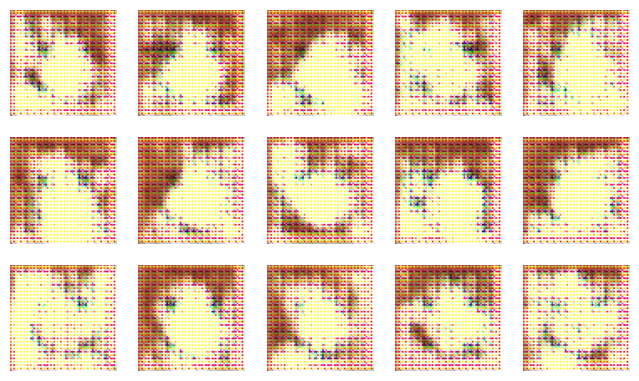

674/674 ━━━━━━━━━━━━━━━━━━━━ 697s 1s/step - d_loss: -0.4043 - g_loss: 0.1186
Epoch 2/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: -0.9335 - g_loss: 0.1586

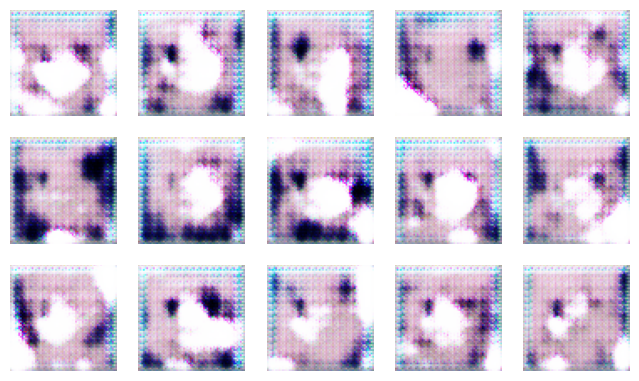

674/674 ━━━━━━━━━━━━━━━━━━━━ 738s 1s/step - d_loss: -0.9333 - g_loss: 0.1586
Epoch 3/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: -0.6888 - g_loss: 0.3900

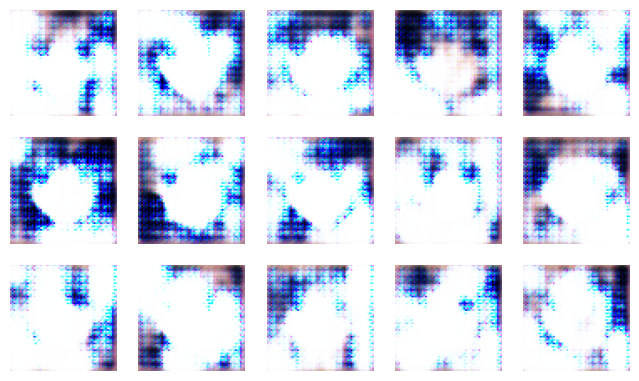

674/674 ━━━━━━━━━━━━━━━━━━━━ 787s 1s/step - d_loss: -0.6893 - g_loss: 0.3897
Epoch 4/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 946ms/step - d_loss: -0.8295 - g_loss: 1.0642

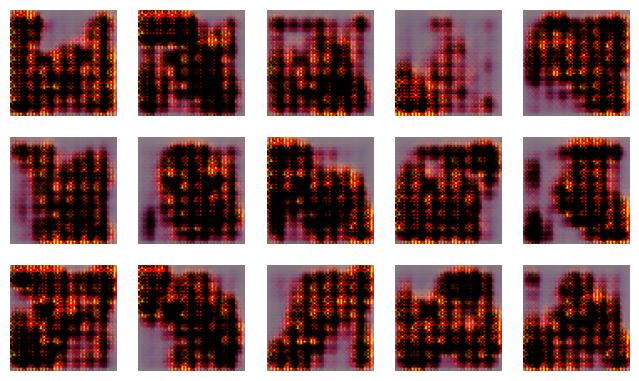

674/674 ━━━━━━━━━━━━━━━━━━━━ 640s 950ms/step - d_loss: -0.8299 - g_loss: 1.0639
Epoch 5/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 938ms/step - d_loss: -2.4706 - g_loss: 0.6728

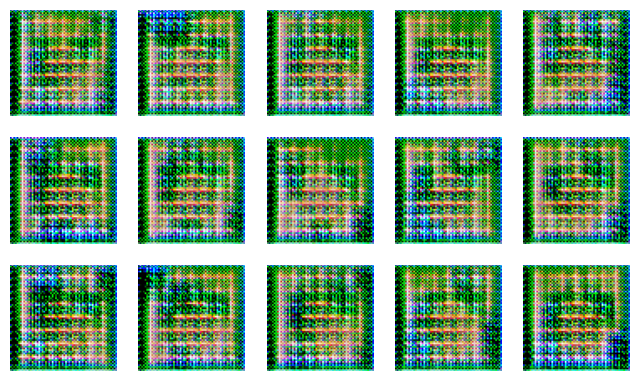

674/674 ━━━━━━━━━━━━━━━━━━━━ 633s 939ms/step - d_loss: -2.4710 - g_loss: 0.6757
Epoch 6/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 919ms/step - d_loss: -3.7429 - g_loss: 1.9744

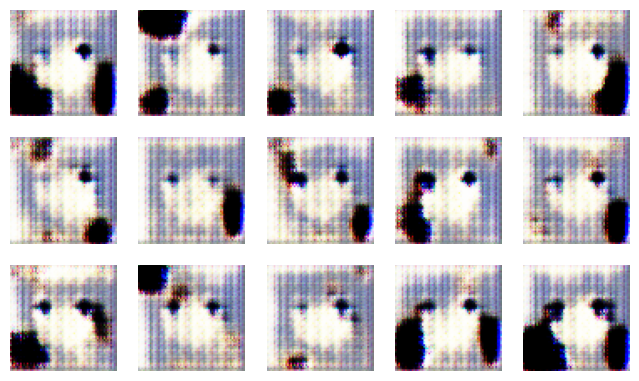

674/674 ━━━━━━━━━━━━━━━━━━━━ 620s 920ms/step - d_loss: -3.7423 - g_loss: 1.9741
Epoch 7/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 910ms/step - d_loss: -3.5879 - g_loss: 1.5627

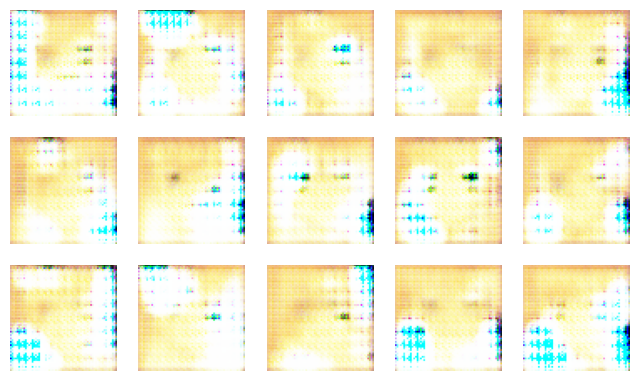

674/674 ━━━━━━━━━━━━━━━━━━━━ 614s 910ms/step - d_loss: -3.5887 - g_loss: 1.5630
Epoch 8/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 912ms/step - d_loss: -5.0529 - g_loss: 2.9368

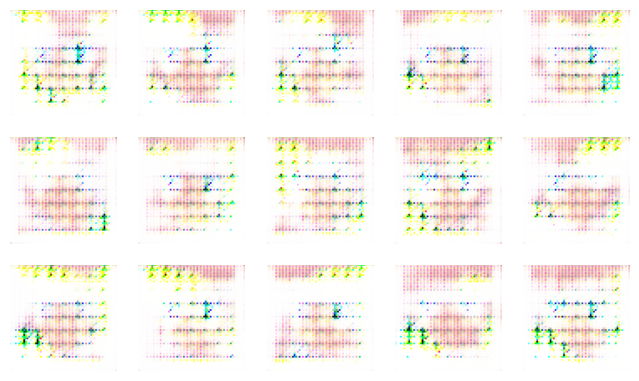

674/674 ━━━━━━━━━━━━━━━━━━━━ 615s 913ms/step - d_loss: -5.0540 - g_loss: 2.9381
Epoch 9/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 920ms/step - d_loss: -7.7190 - g_loss: 1.3780

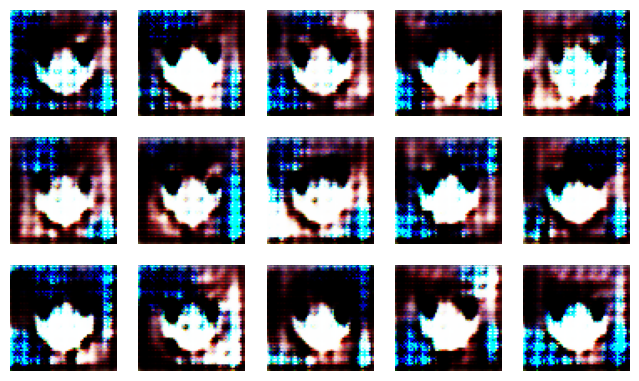

674/674 ━━━━━━━━━━━━━━━━━━━━ 621s 921ms/step - d_loss: -7.7166 - g_loss: 1.3812
Epoch 10/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 921ms/step - d_loss: -7.8124 - g_loss: 0.8077

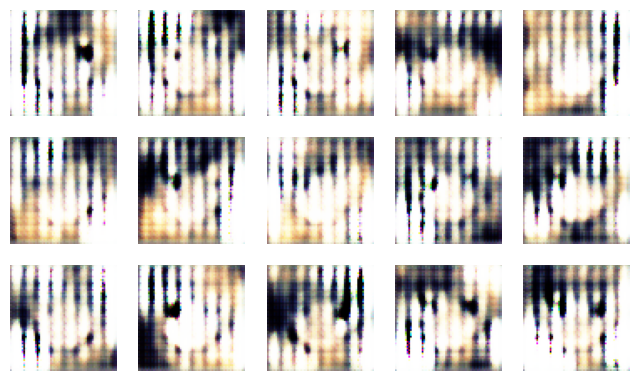

674/674 ━━━━━━━━━━━━━━━━━━━━ 621s 922ms/step - d_loss: -7.8145 - g_loss: 0.8081
Epoch 11/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 917ms/step - d_loss: -5.6337 - g_loss: 8.0491

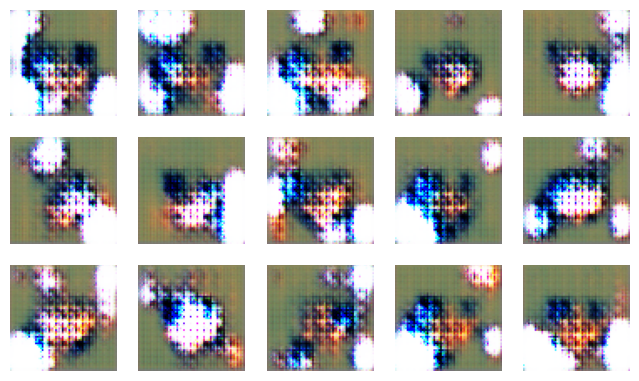

674/674 ━━━━━━━━━━━━━━━━━━━━ 618s 917ms/step - d_loss: -5.6394 - g_loss: 8.0430
Epoch 12/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 917ms/step - d_loss: -12.2140 - g_loss: 5.4707

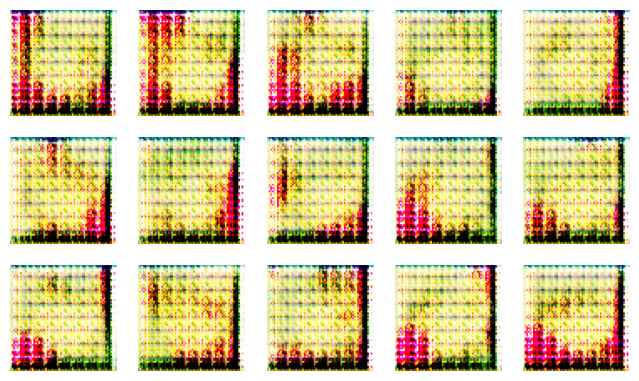

674/674 ━━━━━━━━━━━━━━━━━━━━ 619s 918ms/step - d_loss: -12.2135 - g_loss: 5.4812
Epoch 13/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 913ms/step - d_loss: -12.2307 - g_loss: 9.5015

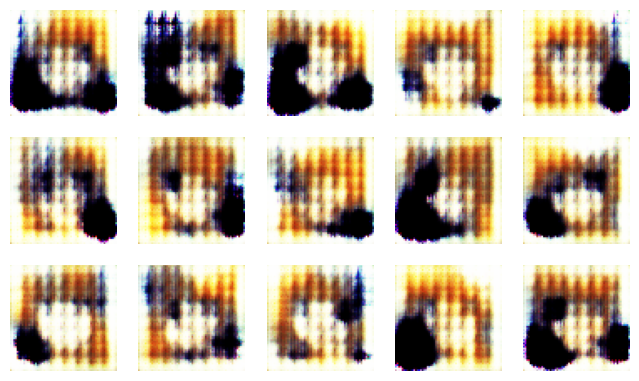

674/674 ━━━━━━━━━━━━━━━━━━━━ 616s 913ms/step - d_loss: -12.2321 - g_loss: 9.4986
Epoch 14/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 909ms/step - d_loss: -14.5147 - g_loss: 15.0657

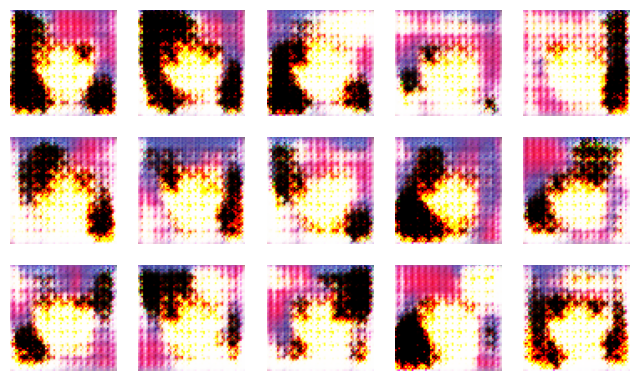

674/674 ━━━━━━━━━━━━━━━━━━━━ 613s 910ms/step - d_loss: -14.5191 - g_loss: 15.0642
Epoch 15/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 921ms/step - d_loss: -19.1811 - g_loss: 13.1898

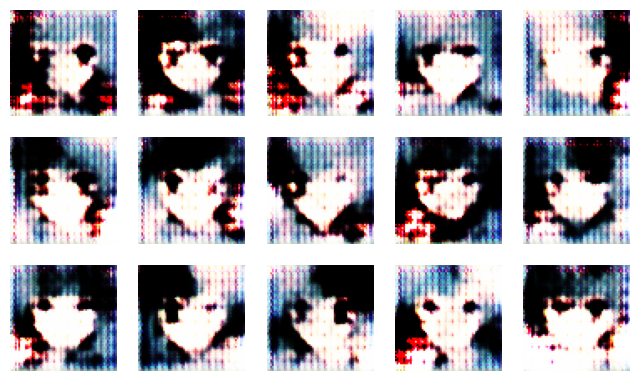

674/674 ━━━━━━━━━━━━━━━━━━━━ 621s 921ms/step - d_loss: -19.1825 - g_loss: 13.1829
Epoch 16/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 911ms/step - d_loss: -23.1900 - g_loss: 19.3577

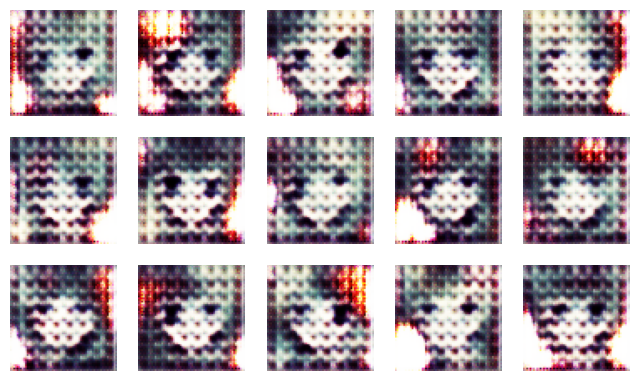

674/674 ━━━━━━━━━━━━━━━━━━━━ 615s 912ms/step - d_loss: -23.1868 - g_loss: 19.3577
Epoch 17/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 910ms/step - d_loss: -18.1652 - g_loss: 16.5745

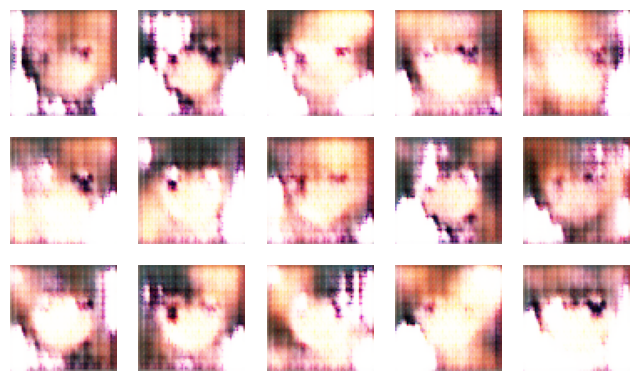

674/674 ━━━━━━━━━━━━━━━━━━━━ 614s 911ms/step - d_loss: -18.1641 - g_loss: 16.5748
Epoch 18/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 908ms/step - d_loss: -19.7201 - g_loss: 10.0732

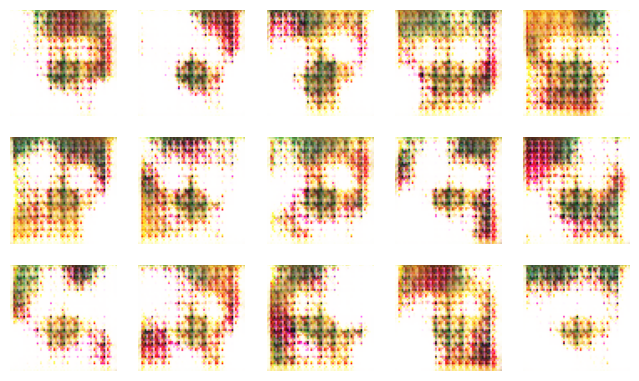

674/674 ━━━━━━━━━━━━━━━━━━━━ 613s 909ms/step - d_loss: -19.7182 - g_loss: 10.0762
Epoch 19/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 923ms/step - d_loss: -20.9590 - g_loss: 6.4626

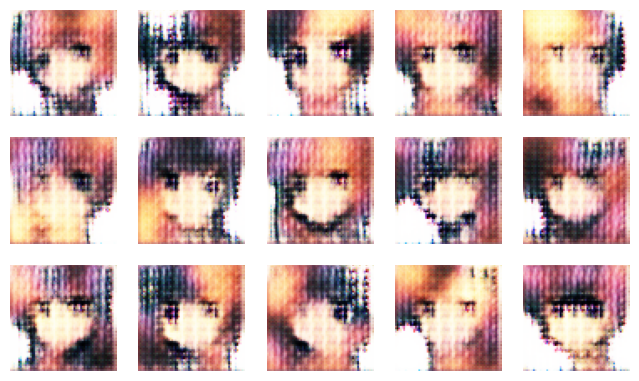

674/674 ━━━━━━━━━━━━━━━━━━━━ 623s 924ms/step - d_loss: -20.9516 - g_loss: 6.4643
Epoch 20/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 942ms/step - d_loss: -14.4516 - g_loss: 7.1856

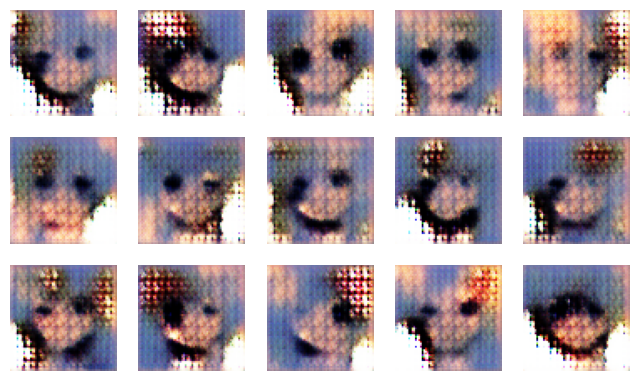

674/674 ━━━━━━━━━━━━━━━━━━━━ 635s 943ms/step - d_loss: -14.4541 - g_loss: 7.1940
Epoch 21/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 936ms/step - d_loss: -28.8497 - g_loss: 4.8333

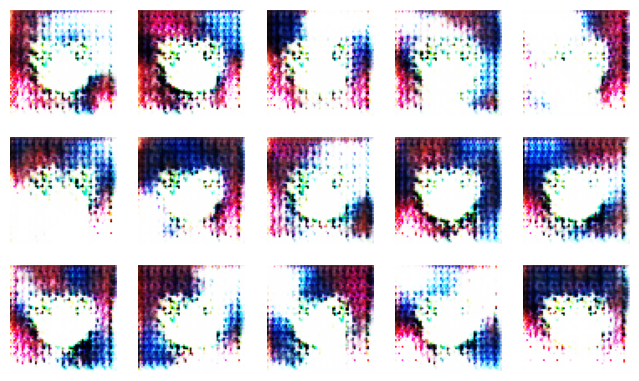

674/674 ━━━━━━━━━━━━━━━━━━━━ 634s 940ms/step - d_loss: -28.8516 - g_loss: 4.8498
Epoch 22/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: -23.9315 - g_loss: 14.6537

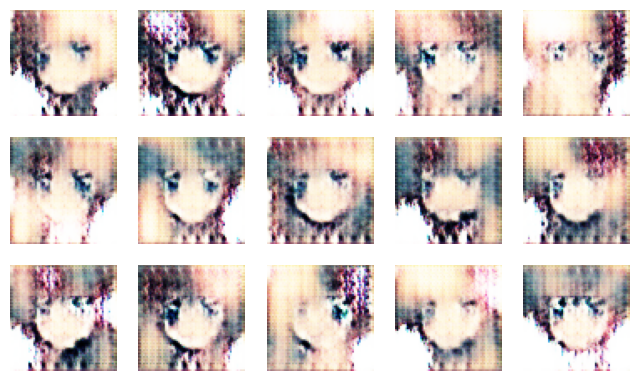

674/674 ━━━━━━━━━━━━━━━━━━━━ 683s 1s/step - d_loss: -23.9252 - g_loss: 14.6511
Epoch 23/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 981ms/step - d_loss: -17.8661 - g_loss: 24.7682

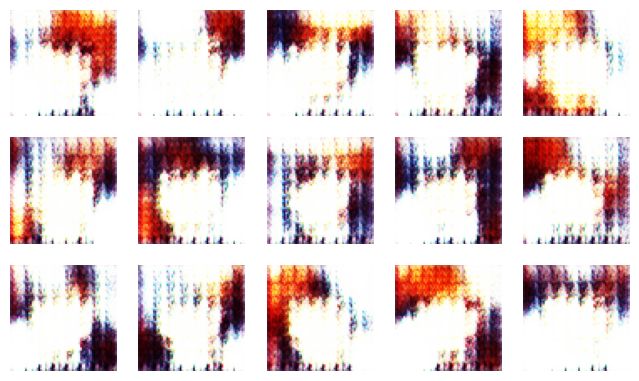

674/674 ━━━━━━━━━━━━━━━━━━━━ 662s 982ms/step - d_loss: -17.8798 - g_loss: 24.7756
Epoch 24/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 912ms/step - d_loss: -28.3546 - g_loss: 21.2830

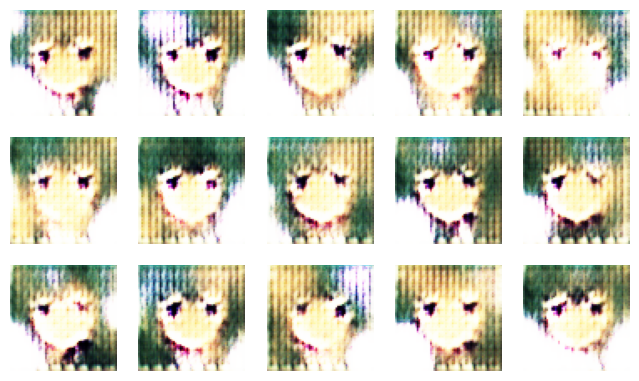

674/674 ━━━━━━━━━━━━━━━━━━━━ 615s 912ms/step - d_loss: -28.3541 - g_loss: 21.2797
Epoch 25/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - d_loss: -7.5120 - g_loss: 24.4313

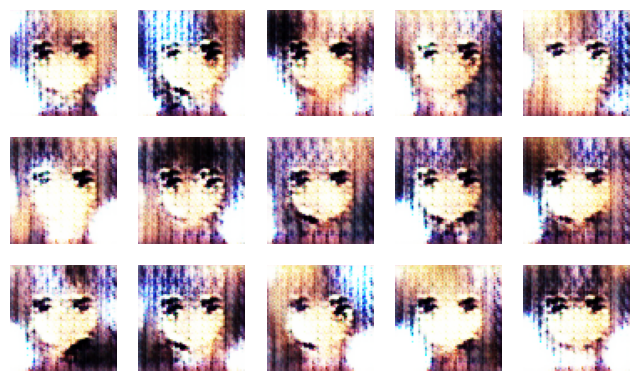

674/674 ━━━━━━━━━━━━━━━━━━━━ 1046s 2s/step - d_loss: -7.5123 - g_loss: 24.4211
Epoch 26/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 981ms/step - d_loss: 4.4329 - g_loss: 20.1391

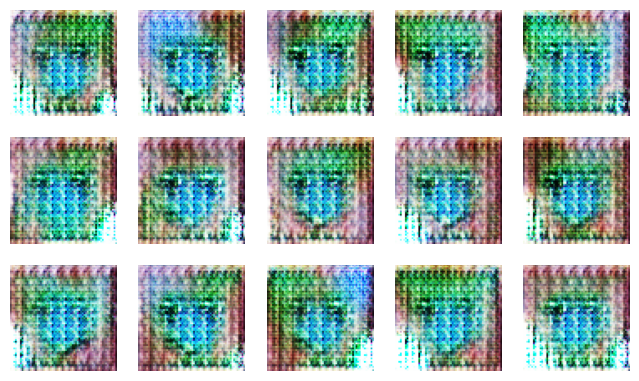

674/674 ━━━━━━━━━━━━━━━━━━━━ 663s 982ms/step - d_loss: 4.4288 - g_loss: 20.1226
Epoch 27/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 948ms/step - d_loss: -11.7331 - g_loss: 19.2985

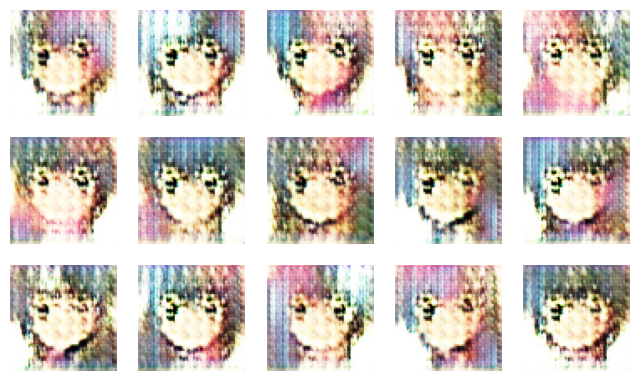

674/674 ━━━━━━━━━━━━━━━━━━━━ 640s 949ms/step - d_loss: -11.7275 - g_loss: 19.2935
Epoch 28/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: -7.4162 - g_loss: 15.7976

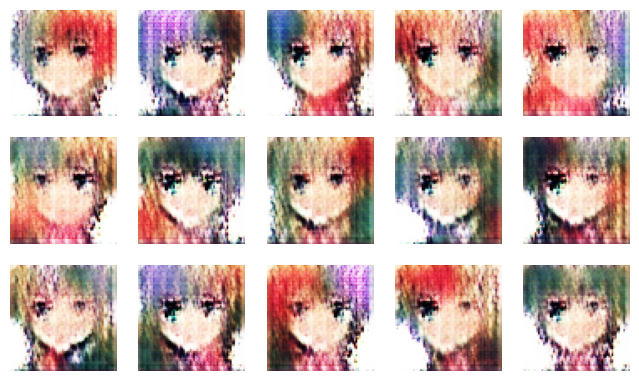

674/674 ━━━━━━━━━━━━━━━━━━━━ 692s 1s/step - d_loss: -7.4102 - g_loss: 15.7899
Epoch 29/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: -7.1523 - g_loss: 5.4384

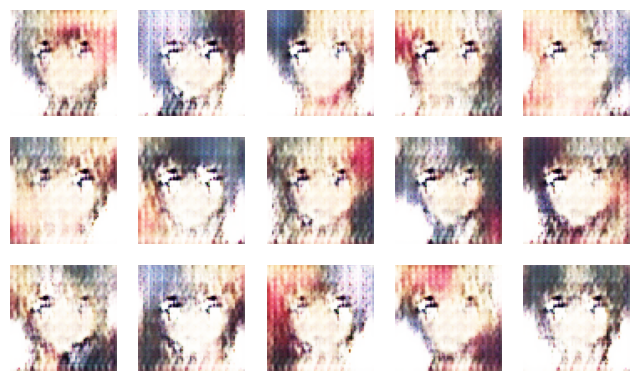

674/674 ━━━━━━━━━━━━━━━━━━━━ 696s 1s/step - d_loss: -7.1613 - g_loss: 5.4411
Epoch 30/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 990ms/step - d_loss: -7.1340 - g_loss: 6.5729

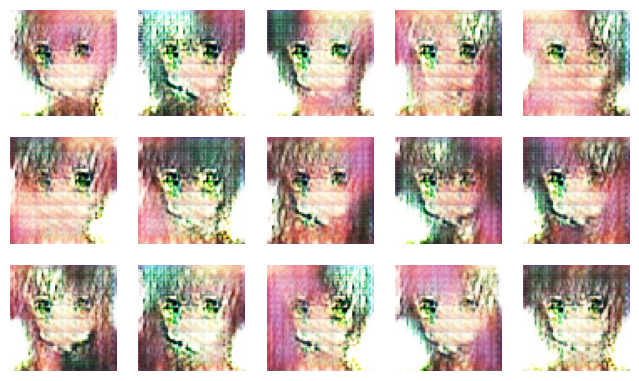

674/674 ━━━━━━━━━━━━━━━━━━━━ 668s 991ms/step - d_loss: -7.1366 - g_loss: 6.5769
Epoch 31/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: -2.8399 - g_loss: 7.1905

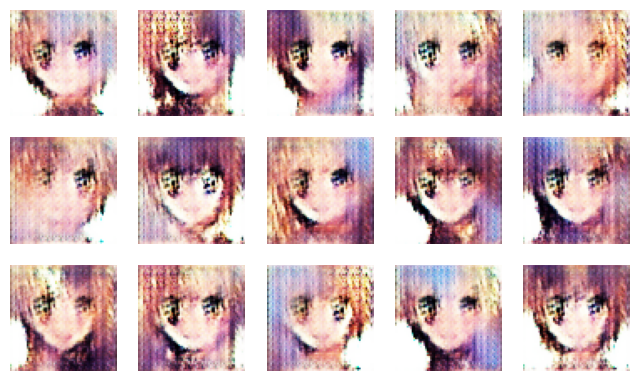

674/674 ━━━━━━━━━━━━━━━━━━━━ 681s 1s/step - d_loss: -2.8404 - g_loss: 7.1969
Epoch 32/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 972ms/step - d_loss: -5.2037 - g_loss: 11.0459

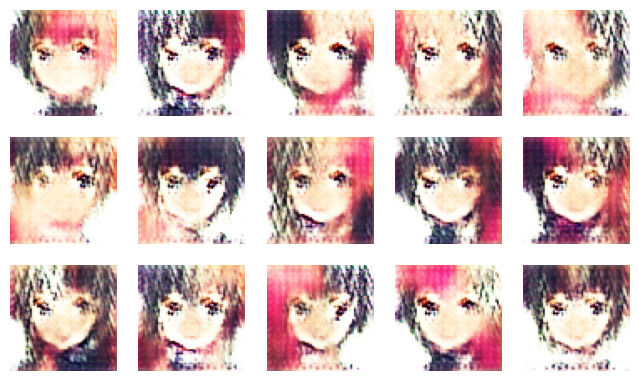

674/674 ━━━━━━━━━━━━━━━━━━━━ 656s 973ms/step - d_loss: -5.2114 - g_loss: 11.0454
Epoch 33/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 26s/step - d_loss: -3.3603 - g_loss: 10.7661 

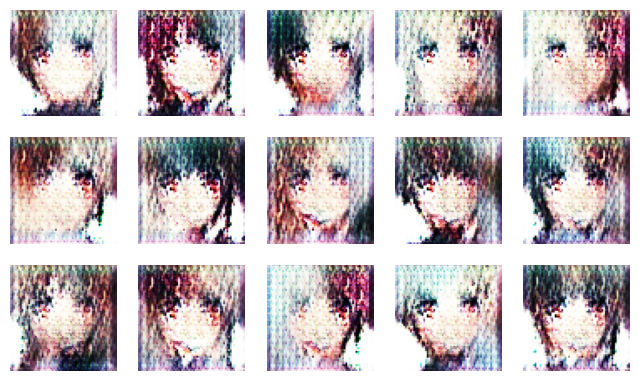

674/674 ━━━━━━━━━━━━━━━━━━━━ 17165s 26s/step - d_loss: -3.3593 - g_loss: 10.7681
Epoch 34/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 996ms/step - d_loss: -0.4387 - g_loss: 9.6925

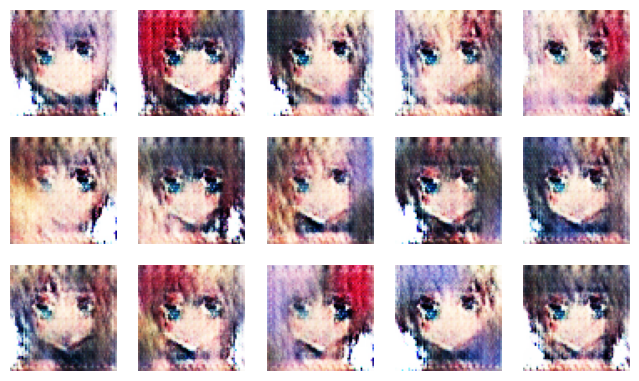

674/674 ━━━━━━━━━━━━━━━━━━━━ 672s 997ms/step - d_loss: -0.4358 - g_loss: 9.6920
Epoch 35/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: 5.9343 - g_loss: 11.8960

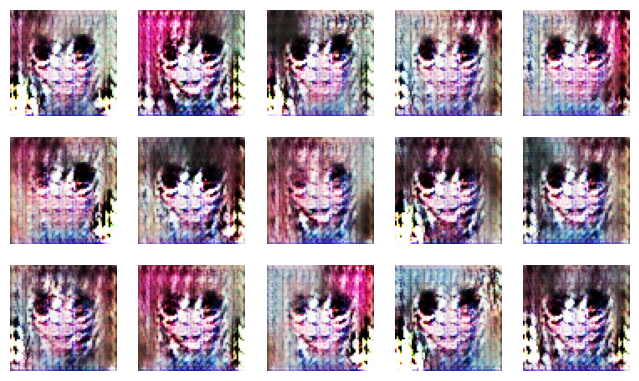

674/674 ━━━━━━━━━━━━━━━━━━━━ 678s 1s/step - d_loss: 5.9282 - g_loss: 11.8922
Epoch 36/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: -5.1517 - g_loss: 13.3164

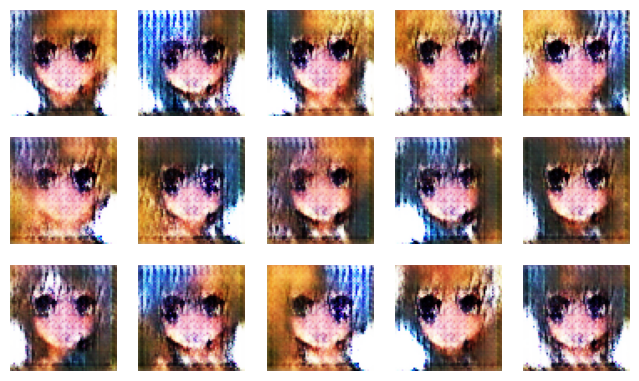

674/674 ━━━━━━━━━━━━━━━━━━━━ 686s 1s/step - d_loss: -5.1517 - g_loss: 13.3103
Epoch 37/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - d_loss: -22.7301 - g_loss: 10.7492

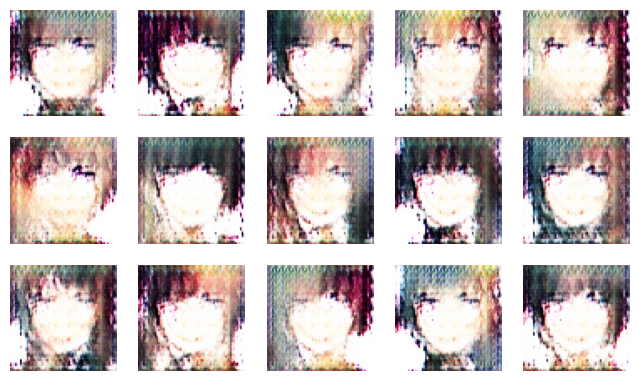

674/674 ━━━━━━━━━━━━━━━━━━━━ 747s 1s/step - d_loss: -22.7151 - g_loss: 10.7534
Epoch 38/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 932ms/step - d_loss: -14.9640 - g_loss: 12.2905

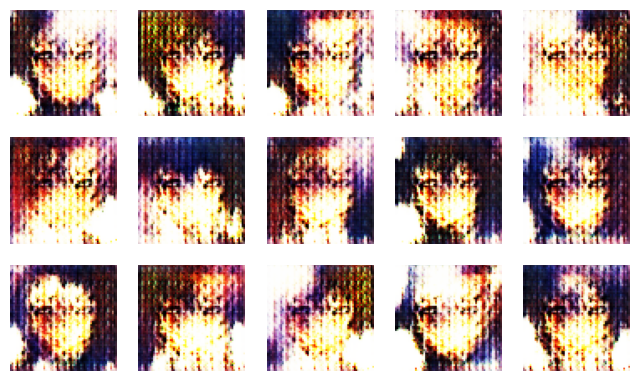

674/674 ━━━━━━━━━━━━━━━━━━━━ 632s 938ms/step - d_loss: -14.9629 - g_loss: 12.2980
Epoch 39/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 948ms/step - d_loss: -14.6704 - g_loss: 14.3286

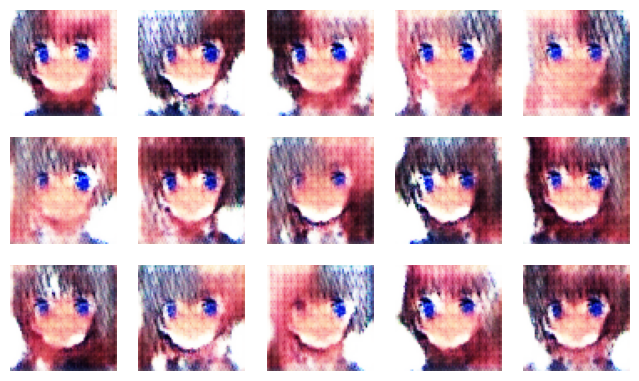

674/674 ━━━━━━━━━━━━━━━━━━━━ 640s 949ms/step - d_loss: -14.6789 - g_loss: 14.3341
Epoch 40/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 919ms/step - d_loss: -14.7499 - g_loss: 10.2885

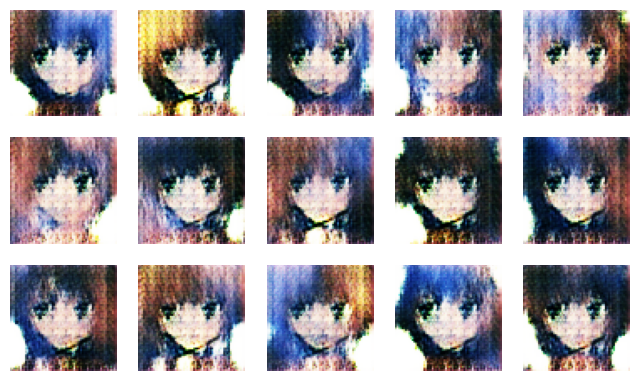

674/674 ━━━━━━━━━━━━━━━━━━━━ 620s 920ms/step - d_loss: -14.7487 - g_loss: 10.2959
Epoch 41/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 942ms/step - d_loss: -22.4978 - g_loss: 19.5148

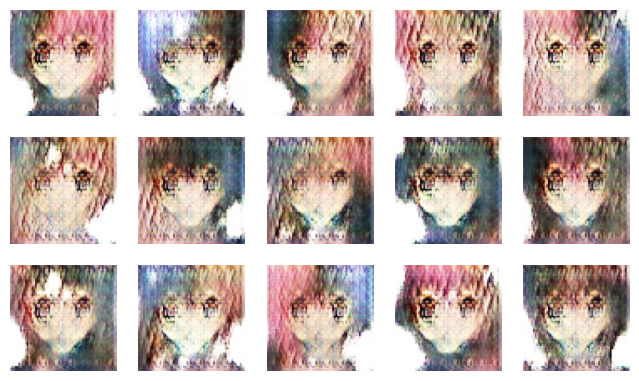

674/674 ━━━━━━━━━━━━━━━━━━━━ 635s 943ms/step - d_loss: -22.4861 - g_loss: 19.5196
Epoch 42/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 922ms/step - d_loss: -0.2009 - g_loss: 9.3976

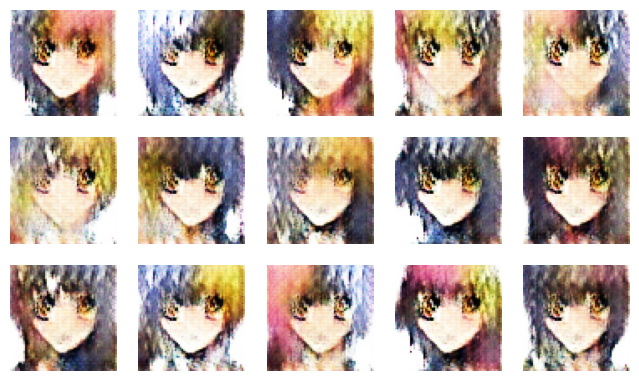

674/674 ━━━━━━━━━━━━━━━━━━━━ 623s 923ms/step - d_loss: -0.1985 - g_loss: 9.4008
Epoch 43/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 909ms/step - d_loss: -0.3777 - g_loss: 12.7741

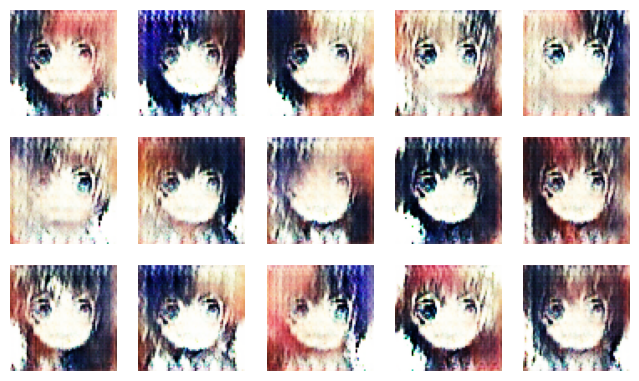

674/674 ━━━━━━━━━━━━━━━━━━━━ 613s 910ms/step - d_loss: -0.3860 - g_loss: 12.7756
Epoch 44/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 941ms/step - d_loss: -4.7771 - g_loss: 8.9581

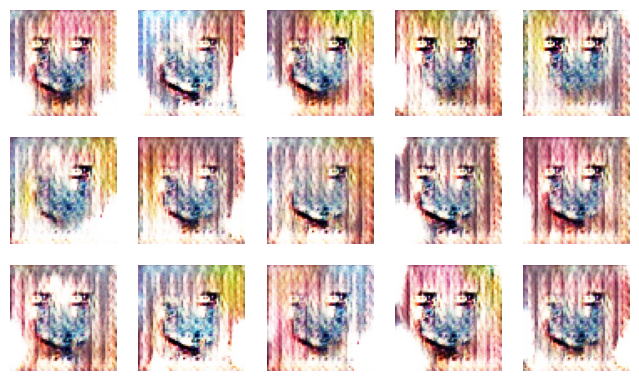

674/674 ━━━━━━━━━━━━━━━━━━━━ 635s 942ms/step - d_loss: -4.7825 - g_loss: 8.9620
Epoch 45/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 939ms/step - d_loss: -31.4203 - g_loss: 10.3295

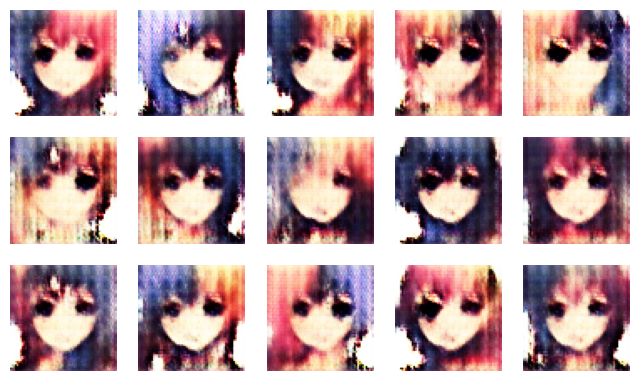

674/674 ━━━━━━━━━━━━━━━━━━━━ 634s 940ms/step - d_loss: -31.4026 - g_loss: 10.3315
Epoch 46/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 918ms/step - d_loss: -12.7470 - g_loss: 34.0920

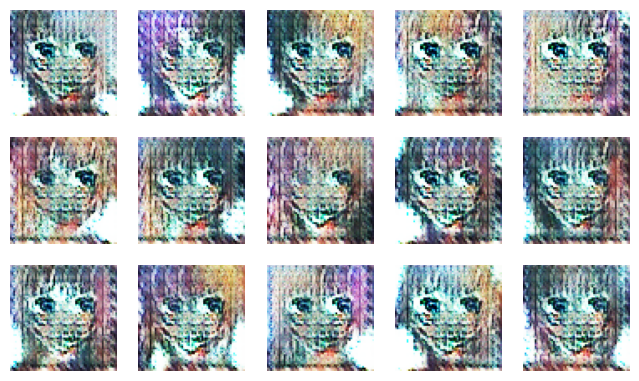

674/674 ━━━━━━━━━━━━━━━━━━━━ 621s 922ms/step - d_loss: -12.7450 - g_loss: 34.0638
Epoch 47/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 925ms/step - d_loss: -5.9445 - g_loss: 32.9769

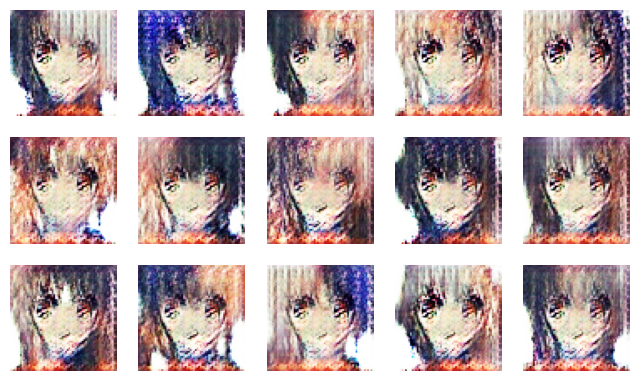

674/674 ━━━━━━━━━━━━━━━━━━━━ 624s 926ms/step - d_loss: -5.9386 - g_loss: 32.9589
Epoch 48/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 917ms/step - d_loss: -1.9274 - g_loss: 11.4760

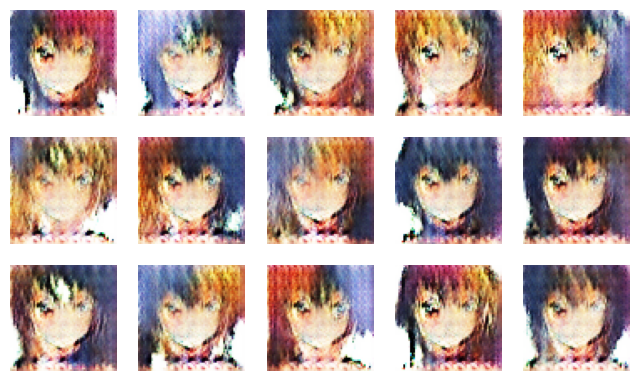

674/674 ━━━━━━━━━━━━━━━━━━━━ 619s 918ms/step - d_loss: -1.9301 - g_loss: 11.4788
Epoch 49/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 930ms/step - d_loss: 2.5200 - g_loss: 21.2123

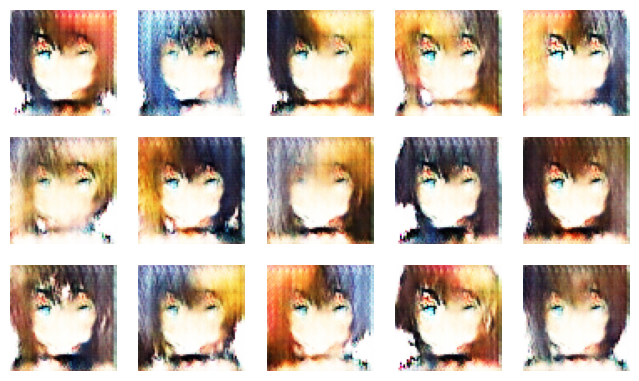

674/674 ━━━━━━━━━━━━━━━━━━━━ 628s 931ms/step - d_loss: 2.5171 - g_loss: 21.1999
Epoch 50/50
674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 919ms/step - d_loss: -4.4576 - g_loss: 10.2721

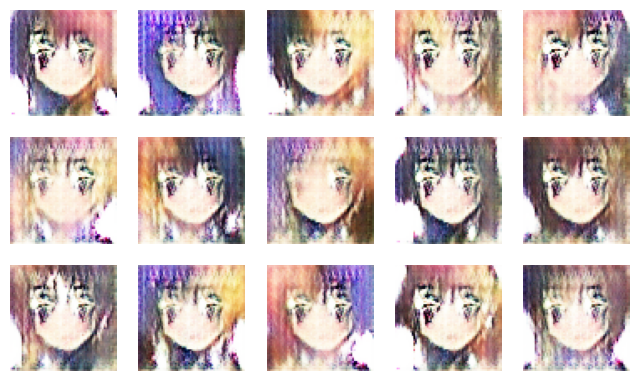

674/674 ━━━━━━━━━━━━━━━━━━━━ 620s 920ms/step - d_loss: -4.4564 - g_loss: 10.2792


In [41]:
N_EPOCHS = 50
dcgan.fit(train_images,epochs=N_EPOCHS, callbacks=[DCGANMonitor()])